In [1]:
import pandas as pd
import numpy as np
import missingno as msno
from IPython.display import display, HTML
display(HTML("<style>.container { width:70% !important; }</style>"))
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
pd.set_option('display.max_columns', None)
import math
import warnings
warnings.filterwarnings("ignore")

import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
import plotly.io as pio
# pio.renderers.default = 'notebook'
pio.renderers.default = "notebook_connected"

# helper functions

In [2]:
def plot_hist_stacked(df1, feature, title):
    
    df = df1.copy()

    df['Fraud Status'] = df['fraud_bool'].map({1: 'Fraud', 0: 'Non-Fraud'})

    fig = px.histogram(df, x=feature, color='Fraud Status',
                       barmode='overlay',  # Overlays the fraud and non-fraud histograms
                       nbins=50,  
                       color_discrete_map={'Fraud':'red', 'Non-Fraud':'green'}, 
                       labels={'Fraud Status':'Fraud Status', feature: feature},  
                       opacity=0.5,  
                       title=title) 

    fig.update_layout(xaxis_title=feature, yaxis_title='Count', legend_title='Fraud Status',
                      width=1800, height=800)  
    fig.show()

    try :
        df['{}_bin'.format(feature)] = pd.cut(df['{}'.format(feature)], bins=50)

        # Calculate the percentage distribution of Fraud Status within each credit_risk_score bin
        distribution = df.groupby(['{}_bin'.format(feature), 'Fraud Status']).size().unstack(fill_value=0)
        distribution_percentage = distribution.div(distribution.sum(axis=1), axis=0) * 100

        distribution_percentage.plot(kind='bar', stacked=True, figsize=(25, 10), color=['red', 'green'])

        plt.axhline(y=distribution_percentage['Fraud'].mean()) 
        plt.axhline(y=50, color='yellow') 

        plt.title(title)
        plt.xlabel('{}_bin'.format(feature))
        plt.ylabel('Percentage')
        plt.legend(title='Fraud Status')
        plt.xticks(rotation=75)

        plt.tight_layout
    except TypeError:
        print('cannot print stacked bar chart as cannot bin')

In [3]:
def plot_fraud_nonfraud(df):

    n_cols = len(df.columns) - 1
    cols_per_row = 4
    rows = math.ceil(n_cols / cols_per_row)

    fig, axs = plt.subplots(rows, cols_per_row, figsize=(20, 10 * rows), constrained_layout=True)

    # Flatten the axes array for easy indexing
    axs = axs.flatten()

    for i, feature in enumerate(df.columns.drop('fraud_bool')):
        # Separate the data by fraud_bool status
        data_fraud = df[df['fraud_bool'] == 1][feature].dropna()
        data_non_fraud = df[df['fraud_bool'] == 0][feature].dropna()

        # Create histograms for each category within the same subplot
        axs[i].hist(data_non_fraud, bins=50, alpha=0.5, label='Non-Fraud', color='green')
        axs[i].hist(data_fraud, bins=50, alpha=0.5, label='Fraud', color='red')

        # Set the title and legend for the subplot
        axs[i].set_title(feature)
        axs[i].legend()

    # Hide any unused subplots
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    plt.tight_layout()
    plt.show()

In [4]:
def plot_distribution(df1):
    
    df = df1.copy()
    
    n_cols = len(df.columns) -1
    cols_per_row = 4
    rows = math.ceil(n_cols / cols_per_row)

    fig, axs = plt.subplots(rows, cols_per_row, figsize=(20, 10 * rows), constrained_layout=True)

    # Flatten the axes array for easy indexing
    axs = axs.flatten()

    for i, feature in enumerate(df.columns.drop('fraud_bool')):
        data = df[feature].dropna()

        # Create histograms for the feature
        axs[i].hist(data, bins=50, alpha=0.5, color='blue')

        # Set the title for the subplot
        axs[i].set_title(feature)
        

    # Hide any unused subplots
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    plt.tight_layout()
    plt.show()

In [5]:
def plot_comparison(df1, df2):
    
    df = df1.copy()
    
    n_cols = len(df.columns) -1
    cols_per_row = 4
    rows = math.ceil(n_cols / cols_per_row)

    fig, axs = plt.subplots(rows, cols_per_row, figsize=(20, 10 * rows), constrained_layout=True)

    # Flatten the axes array for easy indexing
    axs = axs.flatten()

    for i, feature in enumerate(df.columns.drop('fraud_bool')):
        data = df[feature].dropna()
        axs[i].hist(data, bins=50, alpha=0.5,  label='filtered_df')
        axs[i].set_title(feature)
        
        data2 = df2[feature].dropna()
        axs[i].hist(data2, bins=50, alpha=0.5,  label='full_df')
        axs[i].set_title(feature)
        axs[i].legend()

    # Hide any unused subplots
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    plt.tight_layout()
    plt.show()

In [6]:
df_cluster = pd.read_csv('kmeans_5_data.csv')
df_cluster.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52776 entries, 0 to 52775
Data columns (total 27 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   fraud_bool                        52776 non-null  int64  
 1   income                            52776 non-null  float64
 2   name_email_similarity             52776 non-null  float64
 3   current_address_months_count      52776 non-null  float64
 4   customer_age                      52776 non-null  float64
 5   days_since_request                52776 non-null  float64
 6   payment_type                      52776 non-null  object 
 7   zip_count_4w                      52776 non-null  float64
 8   bank_branch_count_8w              52776 non-null  float64
 9   date_of_birth_distinct_emails_4w  52776 non-null  float64
 10  employment_status                 52776 non-null  object 
 11  credit_risk_score                 52776 non-null  float64
 12  emai

In [7]:
df_cluster.head()

,fraud_bool,income,name_email_similarity,current_address_months_count,customer_age,days_since_request,payment_type,zip_count_4w,bank_branch_count_8w,date_of_birth_distinct_emails_4w,employment_status,credit_risk_score,email_is_free,housing_status,phone_home_valid,phone_mobile_valid,bank_months_count,has_other_cards,proposed_credit_limit,foreign_request,device_os,device_distinct_emails_8w,bank_integration,income_credit_limit_ratio,have_prev_address,have_initial_bal,kmeans_label
0,0,1.097434,-0.323517,-0.737581,-0.390680,-0.184397,AB,-0.449854,-0.263554,0.751892,CA,-1.366778,1,BC,0,1,0.017875,0,-0.695968,0,macintosh,-0.147885,-0.121971,1.726620,1,0,4
1,0,0.752880,0.820180,-0.320745,0.410756,-0.185544,AA,-0.782889,-0.383852,-0.625342,CB,-0.417438,0,BC,1,1,0.753097,0,-0.695968,0,other,-0.147885,0.442718,1.396700,0,1,2
2,0,-0.969891,0.135656,-0.151758,-1.192116,-0.186091,AB,0.267069,-0.366030,-0.428594,CA,1.060821,1,BB,0,1,-0.799038,1,1.762963,0,other,-0.147885,-0.686660,-1.110697,0,0,1
3,0,1.097434,-0.408953,-0.523530,0.410756,-0.184564,AC,-0.424926,-0.388307,-1.412333,CA,-0.363190,1,BC,1,1,-0.962421,0,-0.128522,0,windows,4.757703,-0.874890,-0.054951,0,0,3
4,0,0.752880,-1.007143,0.005964,-1.192116,-0.184762,AD,-1.048121,2.371867,1.735630,CB,0.111481,0,BC,0,1,-0.799038,0,-0.128522,0,linux,-0.147885,-0.749403,-0.186920,1,0,4


In [8]:
df_cluster[['kmeans_label', 'fraud_bool']].value_counts()

kmeans_label  fraud_bool
2             0             12477
4             0             11673
0             0             10212
1             0              8521
              1              3894
4             1              1813
2             1              1541
3             0              1074
              1               842
0             1               729
dtype: int64

In [9]:
len(df_cluster[df_cluster['fraud_bool']==1])

8819

# all features

In [10]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    occurrences = df_cluster.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

In [11]:
df_cluster[df_cluster['fraud_bool']==1]['kmeans_label'].value_counts(normalize=True)

1    0.441547
4    0.205579
2    0.174736
3    0.095476
0    0.082662
Name: kmeans_label, dtype: float64

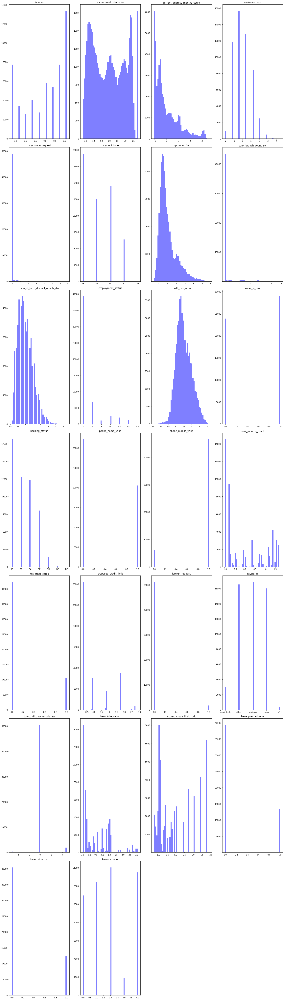

In [12]:
plot_distribution(df_cluster)

## housing_status = BA, label = 3 (73.2%)

In [146]:
df_cluster[(df_cluster['housing_status']=='BA') & (df_cluster['kmeans_label']==3)]['fraud_bool'].value_counts()

1    445
0    163
Name: fraud_bool, dtype: int64

In [145]:
df_cluster[(df_cluster['housing_status']=='BA') & (df_cluster['kmeans_label']==3)]['fraud_bool'].value_counts(normalize=True)

1    0.731908
0    0.268092
Name: fraud_bool, dtype: float64

# label = 1 (31.4%

In [15]:
df_cluster[df_cluster['kmeans_label']==1]['fraud_bool'].value_counts()

0    8521
1    3894
Name: fraud_bool, dtype: int64

In [16]:
df_cluster[df_cluster['kmeans_label']==1]['fraud_bool'].value_counts(normalize=True)

0    0.686347
1    0.313653
Name: fraud_bool, dtype: float64

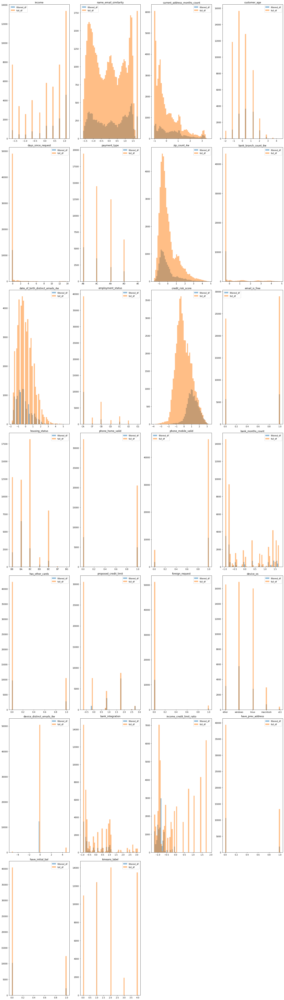

In [17]:
plot_comparison(df_cluster[df_cluster['kmeans_label']==1], df_cluster)

**Description**:
- credit_risk_score more left-skewed with a median of roughly 1
- device_os proportion of windows higher than original distribution 
- bank integration mostly <1.25 and even bigger proportion below feature's mean
- income_credit_limit_ratio below mean
- the rest quite similar to full data

In [18]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['kmeans_label'].isin([1]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

# label = 0 (6.7%)

In [148]:
df_cluster[df_cluster['kmeans_label']==0]['fraud_bool'].value_counts()

0    10212
1      729
Name: fraud_bool, dtype: int64

In [147]:
df_cluster[df_cluster['kmeans_label']==0]['fraud_bool'].value_counts(normalize=True)

0    0.93337
1    0.06663
Name: fraud_bool, dtype: float64

In [149]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['kmeans_label'].isin([0]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

## housing_status = BA (25.7%)

In [150]:
df_cluster[(df_cluster['kmeans_label']==0) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts()

0    633
1    219
Name: fraud_bool, dtype: int64

In [151]:
df_cluster[(df_cluster['kmeans_label']==0) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts(normalize=True)

0    0.742958
1    0.257042
Name: fraud_bool, dtype: float64

# label = 2 (11.0)

In [152]:
df_cluster[df_cluster['kmeans_label']==2]['fraud_bool'].value_counts()

0    12477
1     1541
Name: fraud_bool, dtype: int64

In [153]:
df_cluster[df_cluster['kmeans_label']==2]['fraud_bool'].value_counts(normalize=True)

0    0.89007
1    0.10993
Name: fraud_bool, dtype: float64

In [154]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['kmeans_label'].isin([2]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

## housing_status = BA (30.6%)

In [155]:
df_cluster[(df_cluster['kmeans_label']==2) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts()

0    1534
1     675
Name: fraud_bool, dtype: int64

In [156]:
df_cluster[(df_cluster['kmeans_label']==2) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts(normalize=True)

0    0.694432
1    0.305568
Name: fraud_bool, dtype: float64

# label = 4 (13.4%)

In [29]:
df_cluster[df_cluster['kmeans_label']==4]['fraud_bool'].value_counts()

0    11673
1     1813
Name: fraud_bool, dtype: int64

In [30]:
df_cluster[df_cluster['kmeans_label']==4]['fraud_bool'].value_counts(normalize=True)

0    0.865564
1    0.134436
Name: fraud_bool, dtype: float64

In [31]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['kmeans_label'].isin([4]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

## housing_status = BA (36.2%)

In [32]:
df_cluster[(df_cluster['kmeans_label']==4) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts()

0    1412
1     801
Name: fraud_bool, dtype: int64

In [33]:
df_cluster[(df_cluster['kmeans_label']==4) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts(normalize=True)

0    0.638048
1    0.361952
Name: fraud_bool, dtype: float64

# label = 3 (43.9%)

In [157]:
df_cluster[df_cluster['kmeans_label']==3]['fraud_bool'].value_counts()

0    1074
1     842
Name: fraud_bool, dtype: int64

In [158]:
df_cluster[df_cluster['kmeans_label']==3]['fraud_bool'].value_counts(normalize=True)

0    0.560543
1    0.439457
Name: fraud_bool, dtype: float64

In [159]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['kmeans_label'].isin([3]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

## income > 1 (58.1%)

In [166]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['income']>1)]['fraud_bool'].value_counts()

1    301
0    217
Name: fraud_bool, dtype: int64

In [167]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['income']>1)]['fraud_bool'].value_counts(normalize=True)

1    0.581081
0    0.418919
Name: fraud_bool, dtype: float64

## date_of_birth_distinct_emails_4w > -1.4 (63.2%)

In [168]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['date_of_birth_distinct_emails_4w']< - 1.4)]['fraud_bool'].value_counts()

1    228
0    133
Name: fraud_bool, dtype: int64

In [169]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['date_of_birth_distinct_emails_4w']< -1.4)]['fraud_bool'].value_counts(normalize=True)

1    0.631579
0    0.368421
Name: fraud_bool, dtype: float64

## device_os = windows (62.1%)

In [170]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['device_os']=='windows')]['fraud_bool'].value_counts()

1    522
0    318
Name: fraud_bool, dtype: int64

In [171]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['device_os']=='windows')]['fraud_bool'].value_counts(normalize=True)

1    0.621429
0    0.378571
Name: fraud_bool, dtype: float64

## credit_risk_score >= 0.4 (72.8%)

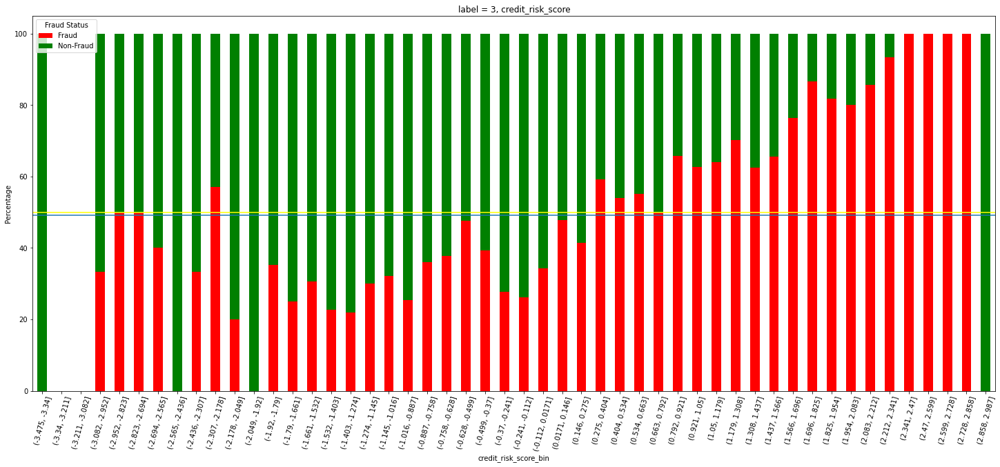

In [172]:
plot_hist_stacked(df_cluster[df_cluster['kmeans_label']==3], 'credit_risk_score', 'label = 3, credit_risk_score')

In [173]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['credit_risk_score']>=0.792)]['fraud_bool'].value_counts()

1    268
0    100
Name: fraud_bool, dtype: int64

In [174]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['credit_risk_score']>=0.792)]['fraud_bool'].value_counts(normalize=True)

1    0.728261
0    0.271739
Name: fraud_bool, dtype: float64

## housing_status = BA (73.2%, 0.6k)

In [177]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts()

1    445
0    163
Name: fraud_bool, dtype: int64

In [178]:
df_cluster[(df_cluster['kmeans_label']==3) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts(normalize=True)

1    0.731908
0    0.268092
Name: fraud_bool, dtype: float64

# date_of_birth_distinct_emails_4w

In [46]:
occurrences = df_cluster.groupby(["kmeans_label", 'date_of_birth_distinct_emails_4w', "fraud_bool"]).size().reset_index(name="Occurrences")
occurrences.sort_values("kmeans_label", inplace=True)
fig = px.scatter(occurrences, x='date_of_birth_distinct_emails_4w', y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
fig.show()

## all

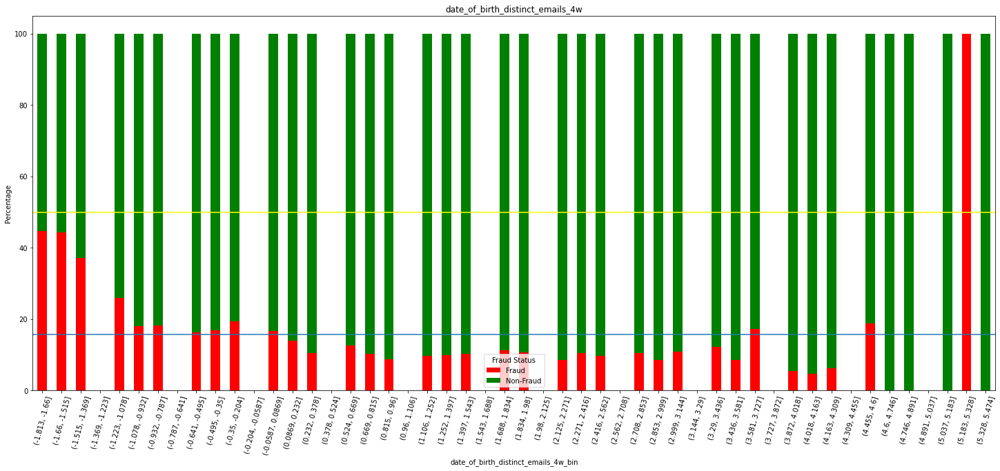

In [47]:
plot_hist_stacked(df_cluster, 'date_of_birth_distinct_emails_4w', 'date_of_birth_distinct_emails_4w')

## label = 1

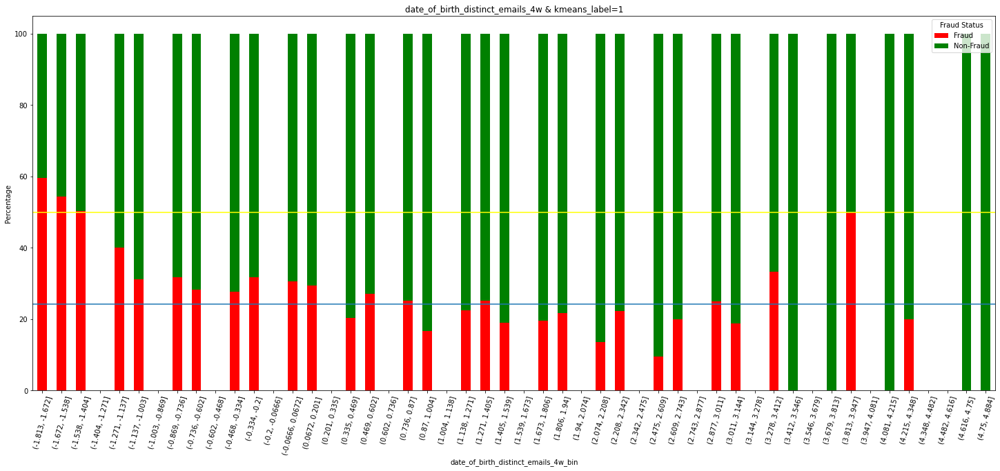

In [48]:
plot_hist_stacked(df_cluster[df_cluster['kmeans_label']==1], 'date_of_birth_distinct_emails_4w', 'date_of_birth_distinct_emails_4w & kmeans_label=1')

### date_of_birth_distinct_emails_4w <=-1.404, label = 1 (52%)

In [180]:
df_cluster[(df_cluster['date_of_birth_distinct_emails_4w']<=-1.404) & (df_cluster['kmeans_label']==1)]['fraud_bool'].value_counts()

1    776
0    715
Name: fraud_bool, dtype: int64

In [181]:
df_cluster[(df_cluster['date_of_birth_distinct_emails_4w']<=-1.404) & (df_cluster['kmeans_label']==1)]['fraud_bool'].value_counts(normalize=True)

1    0.520456
0    0.479544
Name: fraud_bool, dtype: float64

# credit_risk_score

In [51]:
occurrences = df_cluster.groupby(["kmeans_label", 'credit_risk_score', "fraud_bool"]).size().reset_index(name="Occurrences")
occurrences.sort_values("kmeans_label", inplace=True)
fig = px.scatter(occurrences, x='credit_risk_score', y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
fig.show()

## all

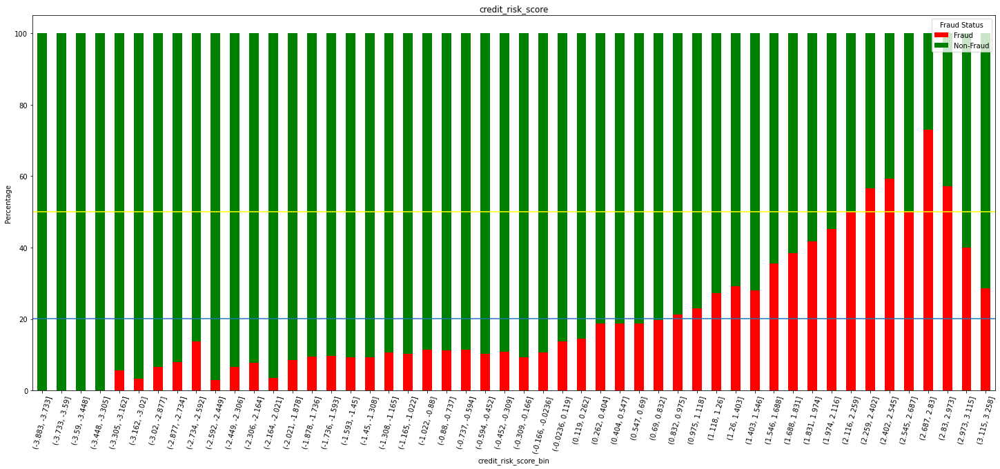

In [52]:
plot_hist_stacked(df_cluster, 'credit_risk_score', 'credit_risk_score')

### credit_risk_score >= 2.2 (57.1%)

In [53]:
df_cluster[(df_cluster['credit_risk_score']>=2.2)]['fraud_bool'].value_counts()

1    643
0    484
Name: fraud_bool, dtype: int64

In [54]:
df_cluster[(df_cluster['credit_risk_score']>=2.2)]['fraud_bool'].value_counts(normalize=True)

1    0.570541
0    0.429459
Name: fraud_bool, dtype: float64

# device_os = windows (30.8%)

In [55]:
occurrences = df_cluster.groupby(["kmeans_label", 'device_os', "fraud_bool"]).size().reset_index(name="Occurrences")
occurrences.sort_values("kmeans_label", inplace=True)
fig = px.scatter(occurrences, x='device_os', y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
fig.show()

In [56]:
df_cluster[(df_cluster['device_os']=='windows') ]['fraud_bool'].value_counts()

0    11679
1     5196
Name: fraud_bool, dtype: int64

In [57]:
df_cluster[(df_cluster['device_os']=='windows') ]['fraud_bool'].value_counts(normalize=True)

0    0.692089
1    0.307911
Name: fraud_bool, dtype: float64

## device+os = windows, label = 3 (62.1%)

In [182]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label']==3)]['fraud_bool'].value_counts()

1    522
0    318
Name: fraud_bool, dtype: int64

In [183]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label']==3)]['fraud_bool'].value_counts(normalize=True)

1    0.621429
0    0.378571
Name: fraud_bool, dtype: float64

## device_os = windows, label = 1 (46.1%)

In [60]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))]['fraud_bool'].value_counts()

0    3095
1    2651
Name: fraud_bool, dtype: int64

In [61]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))]['fraud_bool'].value_counts(normalize=True)

0    0.538636
1    0.461364
Name: fraud_bool, dtype: float64

In [62]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

### income > 1 (58.3%)

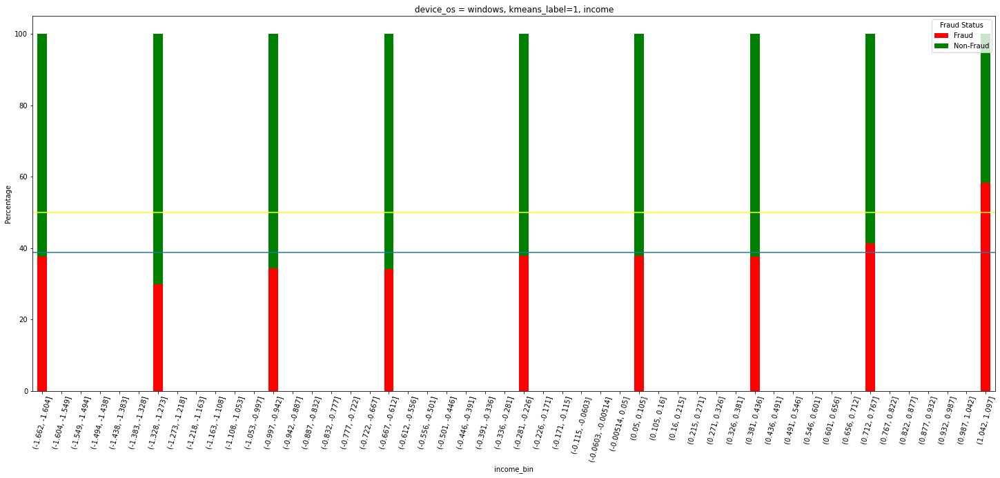

In [63]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'income', 'device_os = windows, kmeans_label=1, income')

In [64]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['income']>1)]['fraud_bool'].value_counts()

1    1371
0     982
Name: fraud_bool, dtype: int64

In [65]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['income']>1)]['fraud_bool'].value_counts(normalize=True)

1    0.58266
0    0.41734
Name: fraud_bool, dtype: float64

### payment type = AC (57.7%)

In [66]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'payment_type', 'device_os = windows, kmeans_label=1, payment_type')

cannot print stacked bar chart as cannot bin


In [67]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['payment_type'].isin(['AC']))]['fraud_bool'].value_counts()

1    989
0    726
Name: fraud_bool, dtype: int64

In [68]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['payment_type'].isin(['AC']))]['fraud_bool'].value_counts(normalize=True)

1    0.576676
0    0.423324
Name: fraud_bool, dtype: float64

### bank_branch_count_8w < -0.385 (57.2%)

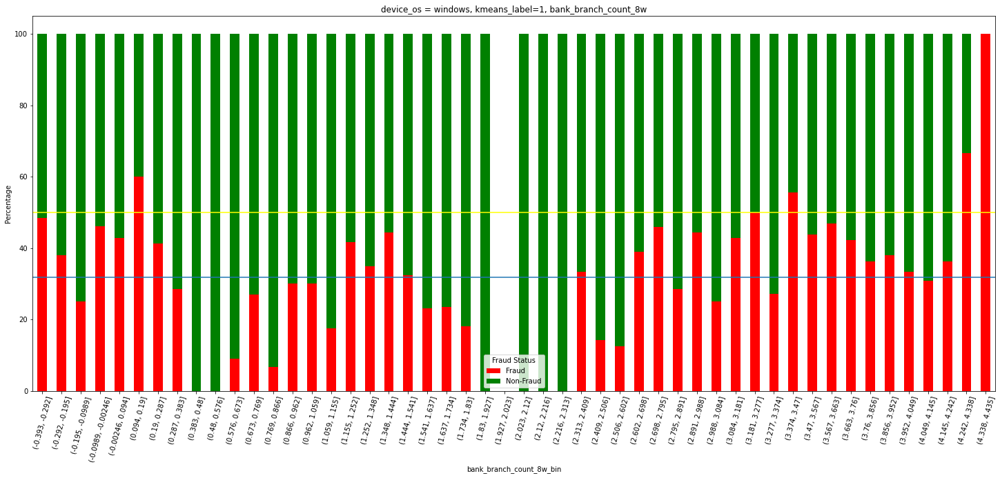

In [69]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'bank_branch_count_8w', 'device_os = windows, kmeans_label=1, bank_branch_count_8w')

In [70]:
temp_df = df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))]
    
occurrences = temp_df.groupby(["kmeans_label", 'bank_branch_count_8w', "fraud_bool"]).size().reset_index(name="Occurrences")
occurrences.sort_values("kmeans_label", inplace=True)
fig = px.scatter(occurrences, x='bank_branch_count_8w', y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
fig.show()

In [71]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['bank_branch_count_8w']<-0.385)]['fraud_bool'].value_counts()

1    1176
0     880
Name: fraud_bool, dtype: int64

In [72]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['bank_branch_count_8w']<-0.386)]['fraud_bool'].value_counts(normalize=True)

1    0.571984
0    0.428016
Name: fraud_bool, dtype: float64

### date_of_birth_distinct_emails_4w <= -1.215 (61.0%)

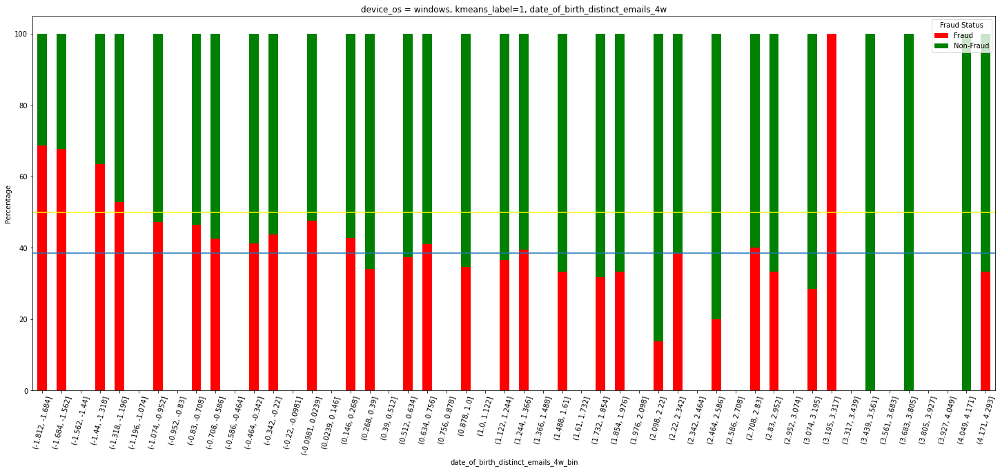

In [73]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'date_of_birth_distinct_emails_4w', 'device_os = windows, kmeans_label=1, date_of_birth_distinct_emails_4w')

In [184]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['date_of_birth_distinct_emails_4w'] < -1.215)]['fraud_bool'].value_counts()

1    785
0    502
Name: fraud_bool, dtype: int64

In [185]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['date_of_birth_distinct_emails_4w'] < -1.215)]['fraud_bool'].value_counts(normalize=True)

1    0.609946
0    0.390054
Name: fraud_bool, dtype: float64

### credit_risk_score >= 1.6 (60.4%))

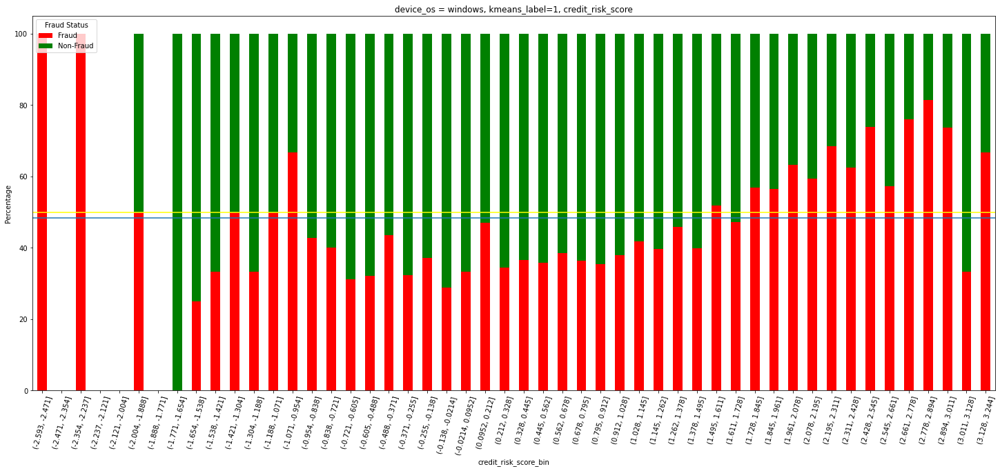

In [76]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'credit_risk_score', 'device_os = windows, kmeans_label=1, credit_risk_score')

In [77]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['credit_risk_score']>=1.6)]['fraud_bool'].value_counts()

1    1111
0     729
Name: fraud_bool, dtype: int64

In [78]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['credit_risk_score']>=1.6)]['fraud_bool'].value_counts(normalize=True)

1    0.603804
0    0.396196
Name: fraud_bool, dtype: float64

### housing status = BA (57.9%)

In [79]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'housing_status', 'device_os = windows, kmeans_label=1, housing_status')

cannot print stacked bar chart as cannot bin


In [80]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts()

1    2019
0    1468
Name: fraud_bool, dtype: int64

In [81]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts(normalize=True)

1    0.579008
0    0.420992
Name: fraud_bool, dtype: float64

In [82]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA')]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

#### income >= 1 (67.6%)

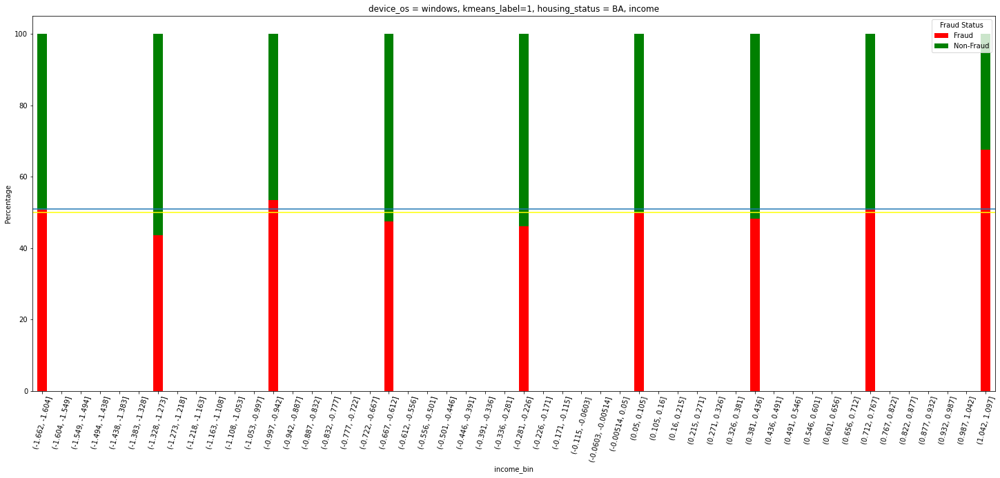

In [83]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') &\
                             (df_cluster['kmeans_label'].isin([1])) &\
                            (df_cluster['housing_status']=='BA')\
                            ], 'income', 'device_os = windows, kmeans_label=1, housing_status = BA, income')

In [84]:
temp_df = df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA')]

occurrences = temp_df.groupby(["kmeans_label", 'income', "fraud_bool"]).size().reset_index(name="Occurrences")
occurrences.sort_values("kmeans_label", inplace=True)
fig = px.scatter(occurrences, x='income', y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
fig.show()

In [85]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['income']>=1)]['fraud_bool'].value_counts()

1    1107
0     531
Name: fraud_bool, dtype: int64

In [86]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['income']>=1)]['fraud_bool'].value_counts(normalize=True)

1    0.675824
0    0.324176
Name: fraud_bool, dtype: float64

#### customer_age > 1 (62.2%)

In [87]:
temp_df = df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA')]

occurrences = temp_df.groupby(["kmeans_label", 'customer_age', "fraud_bool"]).size().reset_index(name="Occurrences")
occurrences.sort_values("kmeans_label", inplace=True)
fig = px.scatter(occurrences, x='customer_age', y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
fig.show()

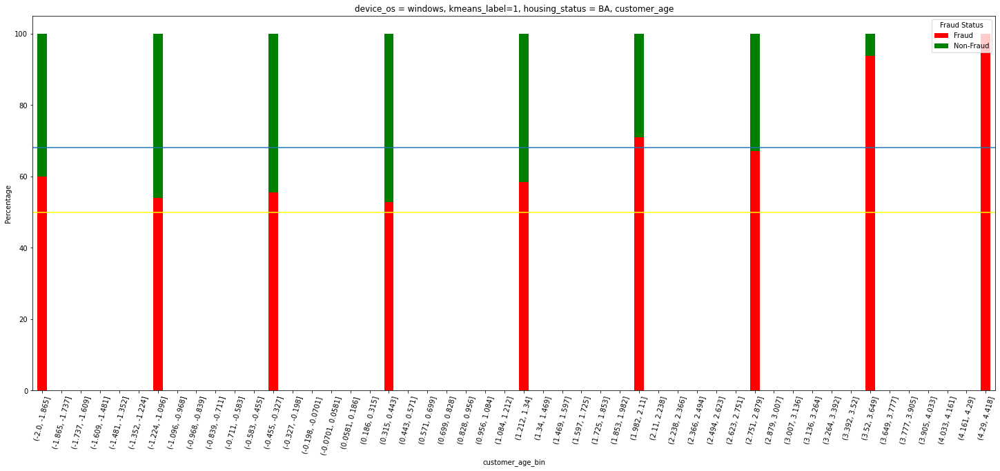

In [88]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') &\
                             (df_cluster['kmeans_label'].isin([1])) &\
                            (df_cluster['housing_status']=='BA')\
                            ], 'customer_age', 'device_os = windows, kmeans_label=1, housing_status = BA, customer_age')

In [89]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['customer_age']> 1)]['fraud_bool'].value_counts()

1    1047
0     635
Name: fraud_bool, dtype: int64

In [90]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['customer_age']> 1)]['fraud_bool'].value_counts(normalize=True)

1    0.622473
0    0.377527
Name: fraud_bool, dtype: float64

#### payment_type = AC (68.9%)

In [91]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') &\
                             (df_cluster['kmeans_label'].isin([1])) &\
                            (df_cluster['housing_status']=='BA')\
                            ], 'payment_type', 'device_os = windows, kmeans_label=1, housing_status = BA, payment_type')

cannot print stacked bar chart as cannot bin


In [92]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['payment_type'].isin(['AC']))]['fraud_bool'].value_counts()

1    772
0    349
Name: fraud_bool, dtype: int64

In [93]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['payment_type'].isin(['AC']))]['fraud_bool'].value_counts(normalize=True)

1    0.688671
0    0.311329
Name: fraud_bool, dtype: float64

#### bank_branch_count_8w <= 0.189 (59.4%)

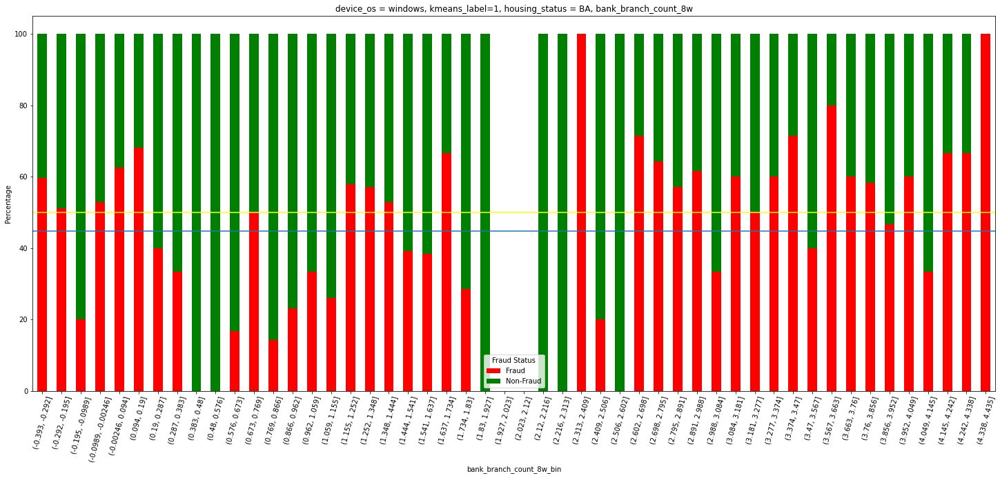

In [94]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') &\
                             (df_cluster['kmeans_label'].isin([1])) &\
                            (df_cluster['housing_status']=='BA')\
                            ], 'bank_branch_count_8w', 'device_os = windows, kmeans_label=1, housing_status = BA, bank_branch_count_8w')

In [186]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['bank_branch_count_8w']<=0.19)]['fraud_bool'].value_counts()

1    1831
0    1250
Name: fraud_bool, dtype: int64

In [187]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['bank_branch_count_8w']<=0.19)]['fraud_bool'].value_counts(normalize=True)

1    0.594288
0    0.405712
Name: fraud_bool, dtype: float64

#### date_of_birth_distinct_emails_4w <= -0.035 (60.1%)

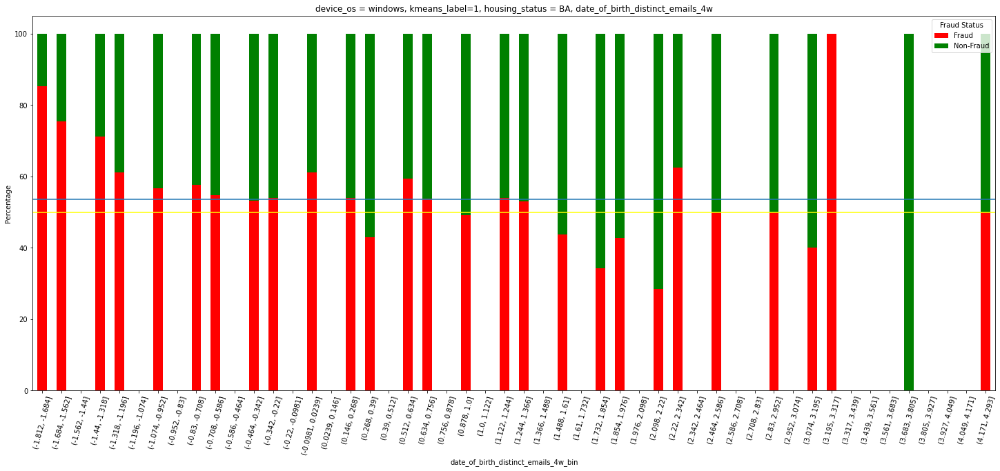

In [97]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') &\
                             (df_cluster['kmeans_label'].isin([1])) &\
                            (df_cluster['housing_status']=='BA')\
                            ], 'date_of_birth_distinct_emails_4w', 'device_os = windows, kmeans_label=1, housing_status = BA, date_of_birth_distinct_emails_4w')

In [188]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['date_of_birth_distinct_emails_4w']<=-0.035)]['fraud_bool'].value_counts()

1    1647
0    1094
Name: fraud_bool, dtype: int64

In [189]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['date_of_birth_distinct_emails_4w']<=-0.035)]['fraud_bool'].value_counts(normalize=True)

1    0.600876
0    0.399124
Name: fraud_bool, dtype: float64

#### bank_months_count <= -0.91 (68.9%)

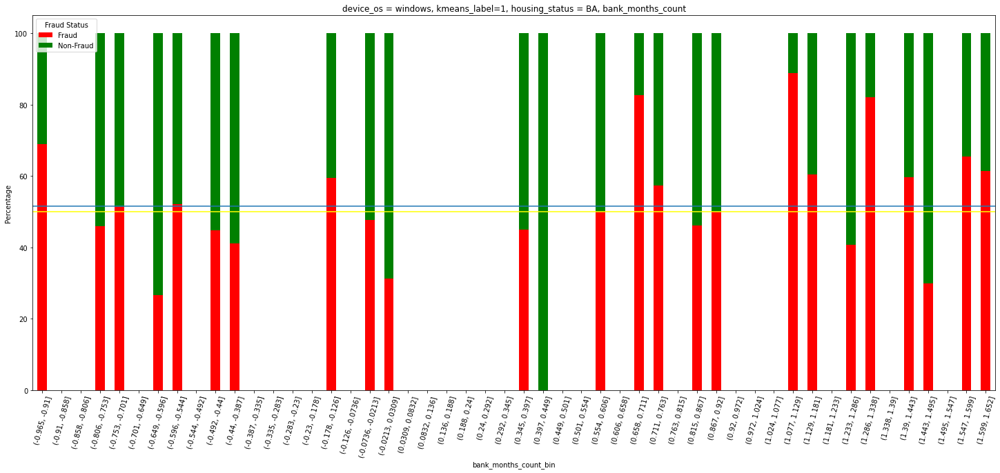

In [100]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') &\
                             (df_cluster['kmeans_label'].isin([1])) &\
                            (df_cluster['housing_status']=='BA')\
                            ], 'bank_months_count', 'device_os = windows, kmeans_label=1, housing_status = BA, bank_months_count')

In [101]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['bank_months_count']<=-0.91)]['fraud_bool'].value_counts()

1    759
0    343
Name: fraud_bool, dtype: int64

In [102]:
df_cluster[(df_cluster['device_os']=='windows') &\
           (df_cluster['kmeans_label'].isin([1])) &\
           (df_cluster['housing_status']=='BA') &\
           (df_cluster['bank_months_count']<=-0.91)]['fraud_bool'].value_counts(normalize=True)

1    0.688748
0    0.311252
Name: fraud_bool, dtype: float64

#### phone_home_valid = 0 (65.3%)

In [103]:
df_cluster[(df_cluster['device_os'] == 'windows') & \
           (df_cluster['kmeans_label'].isin([1])) & \
           (df_cluster['housing_status'].isin(['BA'])) &  \
           (df_cluster['phone_home_valid'].isin([0]))]['fraud_bool'].value_counts()

1    1460
0     777
Name: fraud_bool, dtype: int64

In [104]:
df_cluster[(df_cluster['device_os'] == 'windows') & \
           (df_cluster['kmeans_label'].isin([1])) & \
           (df_cluster['housing_status'].isin(['BA'])) &  \
           (df_cluster['phone_home_valid'].isin([0]))]['fraud_bool'].value_counts(normalize=True)

1    0.65266
0    0.34734
Name: fraud_bool, dtype: float64

### has_other_cards = 0 (62.2%)

In [105]:
df_cluster[(df_cluster['device_os'] == 'windows') & \
           (df_cluster['kmeans_label'].isin([1])) & \
           (df_cluster['housing_status'].isin(['BA'])) &  \
           (df_cluster['has_other_cards'].isin([0]))]['fraud_bool'].value_counts()

1    1841
0    1120
Name: fraud_bool, dtype: int64

In [106]:
df_cluster[(df_cluster['device_os'] == 'windows') & \
           (df_cluster['kmeans_label'].isin([1])) & \
           (df_cluster['housing_status'].isin(['BA'])) &  \
           (df_cluster['has_other_cards'].isin([0]))]['fraud_bool'].value_counts(normalize=True)

1    0.621749
0    0.378251
Name: fraud_bool, dtype: float64

### email_is_free = 1 (53.1%)

In [107]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['email_is_free']==1)]['fraud_bool'].value_counts()

1    1735
0    1534
Name: fraud_bool, dtype: int64

In [108]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['email_is_free']==1)]['fraud_bool'].value_counts(normalize=True)

1    0.530743
0    0.469257
Name: fraud_bool, dtype: float64

### phone_home_valid == 0 (55.0%)

In [109]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0)]['fraud_bool'].value_counts()

1    1944
0    1588
Name: fraud_bool, dtype: int64

In [110]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0)]['fraud_bool'].value_counts(normalize=True)

1    0.550396
0    0.449604
Name: fraud_bool, dtype: float64

### bank_months_count <= -0.901 (57.2%)

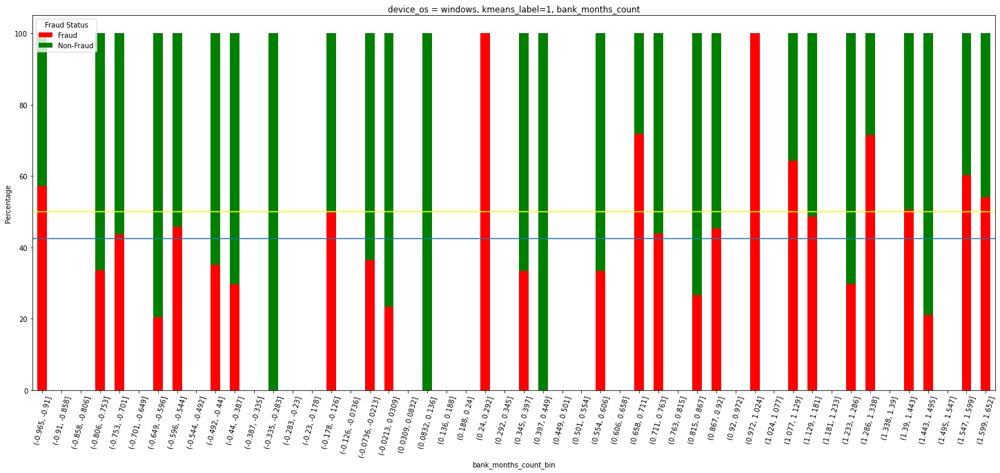

In [111]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'bank_months_count', 'device_os = windows, kmeans_label=1, bank_months_count')

In [191]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['bank_months_count'] <= -0.91)]['fraud_bool'].value_counts()

1    976
0    729
Name: fraud_bool, dtype: int64

In [190]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['bank_months_count'] <= -0.91)]['fraud_bool'].value_counts(normalize=True)

1    0.572434
0    0.427566
Name: fraud_bool, dtype: float64

### proposed_credit_limit >= 2.474 (80.0%)

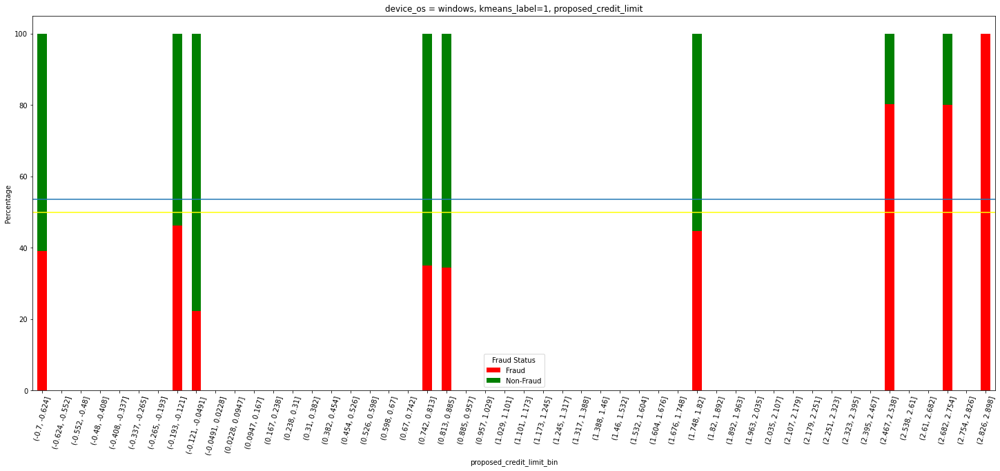

In [114]:
plot_hist_stacked(df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1]))], 'proposed_credit_limit', 'device_os = windows, kmeans_label=1, proposed_credit_limit')

In [115]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['proposed_credit_limit']>=2.474)]['fraud_bool'].value_counts()

1    479
0    118
Name: fraud_bool, dtype: int64

In [116]:
df_cluster[(df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['proposed_credit_limit']>=2.474)]['fraud_bool'].value_counts(normalize=True)

1    0.802345
0    0.197655
Name: fraud_bool, dtype: float64

# phone_home_valid = 0, label = 1 (38.8%)

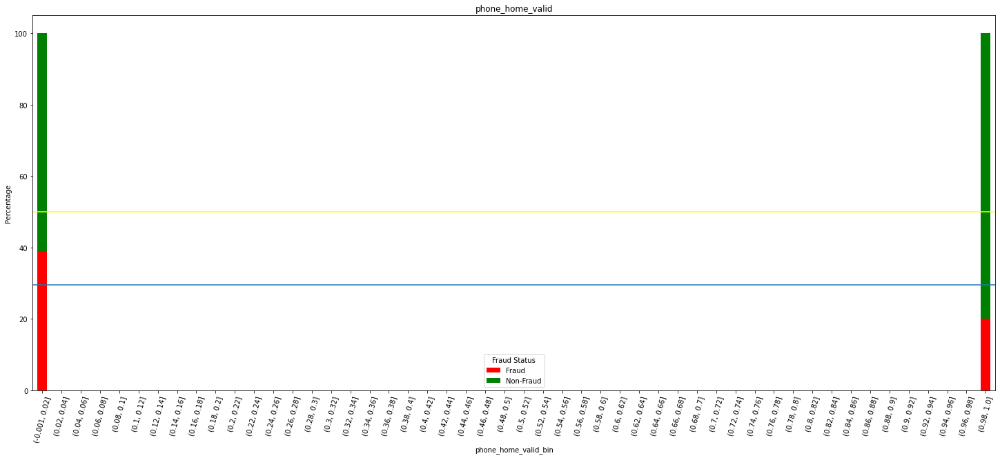

In [117]:
plot_hist_stacked(df_cluster[(df_cluster['kmeans_label'].isin([1]))], 'phone_home_valid', 'phone_home_valid')

In [118]:
df_cluster[(df_cluster['phone_home_valid']==0) & (df_cluster['kmeans_label'].isin([1]))]['fraud_bool'].value_counts()

0    4581
1    2899
Name: fraud_bool, dtype: int64

In [119]:
df_cluster[(df_cluster['phone_home_valid']==0) & (df_cluster['kmeans_label'].isin([1]))]['fraud_bool'].value_counts(normalize=True)

0    0.612433
1    0.387567
Name: fraud_bool, dtype: float64

In [120]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['phone_home_valid']==0) & (df_cluster['kmeans_label'].isin([1]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

## date_of_birth_distinct_emails_4w <= -1.404 (63.7%)

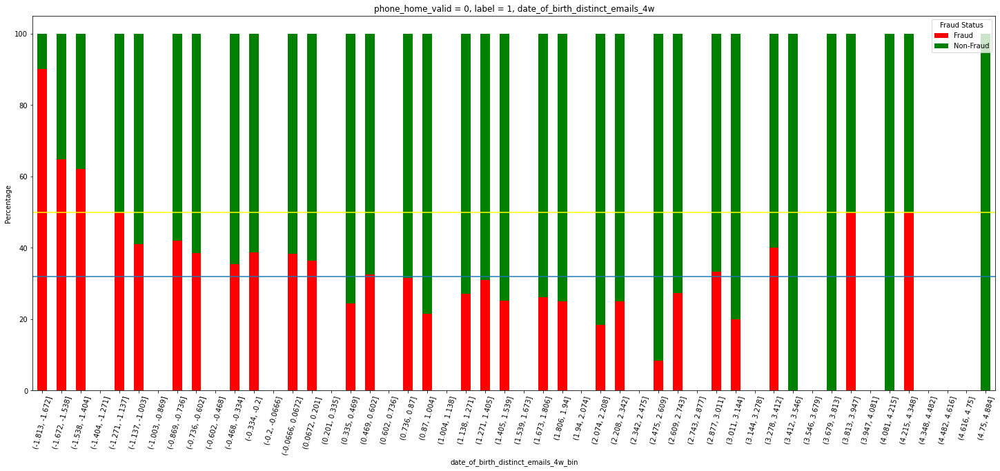

In [121]:
plot_hist_stacked(df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0)], 'date_of_birth_distinct_emails_4w', 'phone_home_valid = 0, label = 1, date_of_birth_distinct_emails_4w')

In [192]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404)]['fraud_bool'].value_counts()

1    479
0    273
Name: fraud_bool, dtype: int64

In [193]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404)]['fraud_bool'].value_counts(normalize=True)

1    0.636968
0    0.363032
Name: fraud_bool, dtype: float64

## housing_status = BA (53.3%, 3.5k)

In [124]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts()

1    2175
0    1938
Name: fraud_bool, dtype: int64

In [125]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['housing_status']=='BA')]['fraud_bool'].value_counts(normalize=True)

1    0.528811
0    0.471189
Name: fraud_bool, dtype: float64

## device_0s = 'windows' (55.0%)

In [126]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['device_os']=='windows')]['fraud_bool'].value_counts()

1    1944
0    1588
Name: fraud_bool, dtype: int64

In [127]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['device_os']=='windows')]['fraud_bool'].value_counts(normalize=True)

1    0.550396
0    0.449604
Name: fraud_bool, dtype: float64

# has_other_cards = 0, label = 1 (36.6%)

In [128]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0)]['fraud_bool'].value_counts()

0    6121
1    3531
Name: fraud_bool, dtype: int64

In [129]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0)]['fraud_bool'].value_counts(normalize=True)

0    0.634169
1    0.365831
Name: fraud_bool, dtype: float64

In [130]:
for col in df_cluster.drop(['fraud_bool', 'kmeans_label'], axis=1).columns:
    
    temp_df = df_cluster[(df_cluster['has_other_cards']==0) & (df_cluster['kmeans_label'].isin([1]))]
    
    occurrences = temp_df.groupby(["kmeans_label", col, "fraud_bool"]).size().reset_index(name="Occurrences")
    occurrences.sort_values("kmeans_label", inplace=True)
    fig = px.scatter(occurrences, x=col, y='kmeans_label', size="Occurrences", size_max=30, color='fraud_bool')
    fig.show()

## date_of_birth_distinct_emails_4w <= -1.404 (58.1%)

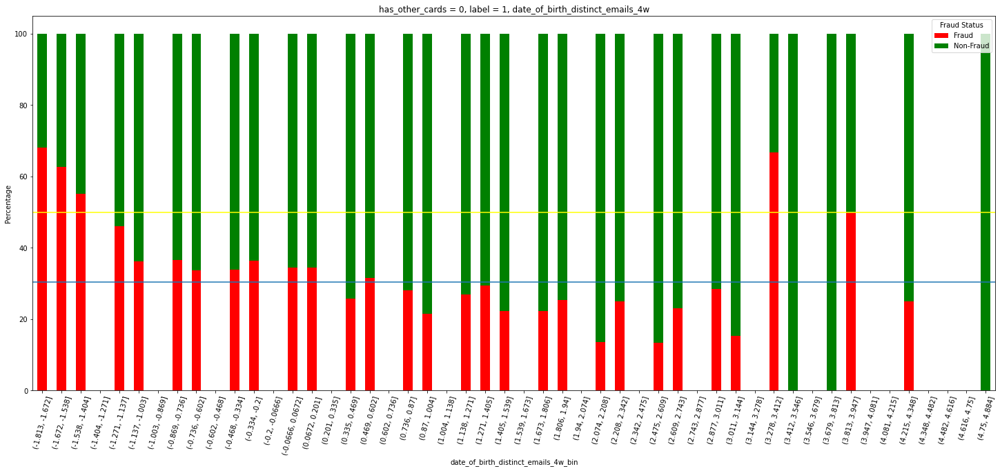

In [131]:
plot_hist_stacked(df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0)], 'date_of_birth_distinct_emails_4w', 'has_other_cards = 0, label = 1, date_of_birth_distinct_emails_4w')

In [194]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0) & (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404)]['fraud_bool'].value_counts()

1    702
0    506
Name: fraud_bool, dtype: int64

In [195]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0) & (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404)]['fraud_bool'].value_counts(normalize=True)

1    0.581126
0    0.418874
Name: fraud_bool, dtype: float64

## credit_risk_score >= 2.2 (62.0%)

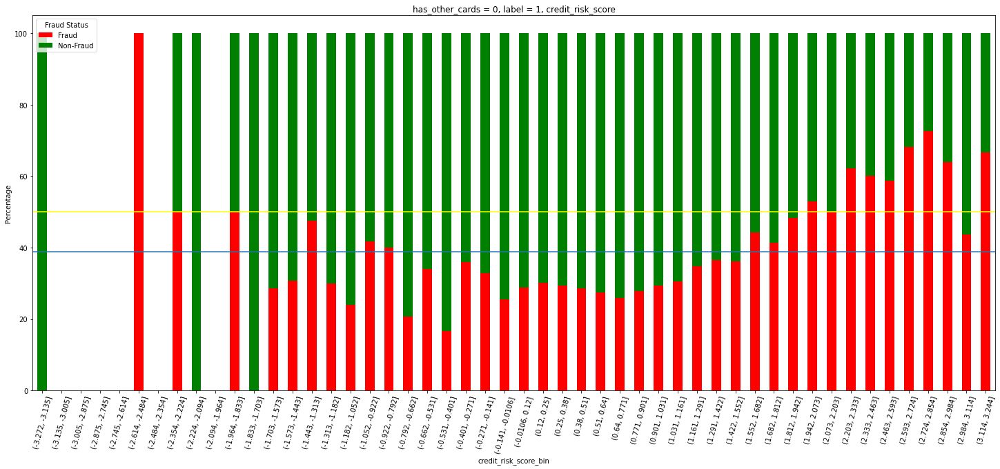

In [134]:
plot_hist_stacked(df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0)], 'credit_risk_score', 'has_other_cards = 0, label = 1, credit_risk_score')

In [196]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0) & (df_cluster['credit_risk_score']>=2.2)]['fraud_bool'].value_counts()

1    523
0    320
Name: fraud_bool, dtype: int64

In [198]:
df_cluster[(df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0) & (df_cluster['credit_risk_score']>=2.2)]['fraud_bool'].value_counts(normalize=True)

1    0.620403
0    0.379597
Name: fraud_bool, dtype: float64

# collect conditions and probabilities

In [207]:
condition_list = [
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['proposed_credit_limit']>=2.474),
        (df_cluster['housing_status']=='BA') & (df_cluster['kmeans_label']==3),
        (df_cluster['kmeans_label']==3) & (df_cluster['housing_status']=='BA'),
        (df_cluster['kmeans_label']==3) & (df_cluster['credit_risk_score']>=0.792),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) &(df_cluster['housing_status']=='BA') &(df_cluster['bank_months_count']<=-0.91),
        (df_cluster['device_os']=='windows') &(df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA') & (df_cluster['bank_months_count']<=-0.91),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) &(df_cluster['housing_status']=='BA') & (df_cluster['payment_type'].isin(['AC'])),
        (df_cluster['device_os']=='windows') &(df_cluster['kmeans_label'].isin([1])) &(df_cluster['housing_status']=='BA') &(df_cluster['income']>=1),
        (df_cluster['device_os'] == 'windows') &   (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status'].isin(['BA'])) &   (df_cluster['phone_home_valid'].isin([0])),
        (df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404),
        (df_cluster['kmeans_label']==3) & (df_cluster['date_of_birth_distinct_emails_4w']< -1.4),
        (df_cluster['device_os']=='windows') &(df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA') &(df_cluster['customer_age']> 1),
        (df_cluster['device_os'] == 'windows') &  (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status'].isin(['BA'])) & (df_cluster['has_other_cards'].isin([0])),
        (df_cluster['kmeans_label']==3) & (df_cluster['device_os']=='windows'),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label']==3),
        (df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0) & (df_cluster['credit_risk_score']>=2.2),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['date_of_birth_distinct_emails_4w'] < -1.215),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['credit_risk_score']>=1.6),
        (df_cluster['device_os']=='windows') &(df_cluster['kmeans_label'].isin([1])) &(df_cluster['housing_status']=='BA') & (df_cluster['date_of_birth_distinct_emails_4w']<=-0.035),
        (df_cluster['device_os']=='windows') &(df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA') & (df_cluster['bank_branch_count_8w']<=0.19),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['income']>1),
        (df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0) & (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404),
        (df_cluster['kmeans_label']==3) & (df_cluster['income']>1),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['housing_status']=='BA'),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['payment_type'].isin(['AC'])),
       (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['bank_months_count'] <= -0.91),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['bank_branch_count_8w']<-0.386),
        (df_cluster['credit_risk_score']>=2.2),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0),
        (df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['device_os']=='windows'),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])) & (df_cluster['email_is_free']==1),
        (df_cluster['kmeans_label'].isin([1])) & (df_cluster['phone_home_valid']==0) & (df_cluster['housing_status']=='BA'),
       (df_cluster['date_of_birth_distinct_emails_4w']<=-1.404) & (df_cluster['kmeans_label']==1),
        (df_cluster['device_os']=='windows') & (df_cluster['kmeans_label'].isin([1])),
        (df_cluster['kmeans_label']==3),
       (df_cluster['phone_home_valid']==0) & (df_cluster['kmeans_label'].isin([1])),
        (df_cluster['kmeans_label'].isin([1])) & (df_cluster['has_other_cards']==0),
        (df_cluster['kmeans_label']==4) & (df_cluster['housing_status']=='BA'),
       (df_cluster['kmeans_label']==1),
       (df_cluster['device_os']=='windows') ,
        (df_cluster['kmeans_label']==2) & (df_cluster['housing_status']=='BA'),
        (df_cluster['kmeans_label']==0) & (df_cluster['housing_status']=='BA'),
        (df_cluster['kmeans_label']==4),
        (df_cluster['kmeans_label']==2),
        (df_cluster['kmeans_label']==0)
                   ]


In [208]:
prob_list = [0.802345059,
                0.731907895,
                0.731907895,
                0.72826087,
                0.688747731,
                0.688747731,
                0.68867083,
                0.675824176,
                0.652659812,
                0.636968085,
                0.631578947,
                0.622473246,
                0.621749409,
                0.621428571,
                0.621428571,
                0.620403321,
                0.60994561,
                0.603804348,
                0.600875593,
                0.594287569,
                0.582660433,
                0.581125828,
                0.581081081,
                0.579007743,
                0.576676385,
                0.572434018,
                0.571984436,
                0.57054126,
                0.550396376,
                0.550396376,
                0.530743347,
                0.528811087,
                0.52045607,
                0.461364427,
                0.439457203,
                0.387566845,
                0.365830916,
                0.361952101,
                0.313652839,
                0.307911111,
                0.30556813,
                0.257042254,
                0.134435711,
                0.10993009,
                0.066630107
                ]

In [210]:
len(condition_list)

45

In [209]:
len(prob_list)

45